# Objective: fine-tuning DETR
-   Official DETR repository: https://github.com/facebookresearch/detr

## Define useful boilerplate functions

Adapted from:
-   https://colab.research.google.com/github/facebookresearch/detr/blob/colab/notebooks/detr_attention.ipynb

In [24]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

torch.set_grad_enabled(False);

2.1.1 False


In [25]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cpu')

In [26]:
import torchvision.transforms as T

# standard PyTorch mean-std input image normalization
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def filter_bboxes_from_outputs(outputs,
                               threshold=0.7):

  # keep only predictions with confidence above threshold
  probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  probas_to_keep = probas[keep]

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)

  return probas_to_keep, bboxes_scaled

COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

## Load pre-trained weights

Load a check-point (urls can be found [here](https://github.com/facebookresearch/detr#model-zoo)), then remove the classification head.

In [27]:
%matplotlib inline
import pycocotools.coco as coco
from pycocotools.coco import COCO
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

## Fine-tuning

In [28]:
num_classes = 2
finetuned_classes = ['Metal', 'Wooden']

First class index: 1
Parameter num_classes: 2
Fine-tuned classes: ['Metal', 'Wooden']


## Loading fine-tuned model

In [29]:
model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=num_classes)

checkpoint = torch.load('models/checkpoint_Q1.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval();

Using cache found in /Users/kevin/.cache/torch/hub/facebookresearch_detr_main
/Users/kevin/anaconda3/envs/streetwatch/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/kevin/anaconda3/envs/streetwatch/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [30]:
def plot_finetuned_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
      for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
          cl = p.argmax()
          text = f'{finetuned_classes[cl]}: {p[cl]:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [31]:
min_area = 10000
min_height = 250

print("Bounding Box Area:", min_area)
print("Min Height ", min_height)

Bounding Box Area: 10000
Min Height  250


In [32]:
#!pip install psycopg2

In [33]:
import psycopg2

conn = psycopg2.connect(
    host = 'localhost',
    database='mydatabase',
    user = 'dsc180b',
    password = 'dsc180b'
)

cur = conn.cursor()

In [34]:
cur.execute(
    '''
    CREATE TABLE mypoles (
        id SERIAL PRIMARY KEY,
        latitude DOUBLE PRECISION,
        longitude DOUBLE PRECISION,
        type VARCHAR(6)
    )
    '''
)

In [35]:
def run_worflow(my_image, my_model, img_name):
      # mean-std normalize the input image (batch-size: 1)
  img = transform(my_image).unsqueeze(0)

  # propagate through the model
  outputs = my_model(img)

  for threshold in [0.75]:

    probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                              threshold=threshold)
    
    if probas_to_keep is not None and bboxes_scaled is not None:
        for p, (xmin, ymin, xmax, ymax)in zip(probas_to_keep, bboxes_scaled.tolist()):
            cl = p.argmax()
            
            img_split = img_name.split('_')
            latitude = img_split[2]
            longitude = img_split[3][:-4]
            pole_type = finetuned_classes[cl]
            
            cur_area = (xmax - xmin) * (ymax - ymin)
            cur_height = ymax - ymin
            
            if cur_area > min_area:
            #if height > min_height:
                insert_query = f" \
                INSERT INTO mypoles (latitude, longitude, type) VALUES \
                ({latitude}, {longitude}, '{pole_type}') \
                "
                
                cur.execute(insert_query)
                
                print(True)

    plot_finetuned_results(my_image,
                           probas_to_keep,
                           bboxes_scaled)


### With a training image

In [36]:
from PIL import Image
import glob

import re

# To sort images because it was doing left0, left1, left10, instead of left0, left1, left2
def natural_sort_key(s):
    return [int(text) if text.isdigit() else text.lower() for text in re.split('([0-9]+)', s)]

test/left0_-90_32.6781445_-117.098631.jpg


HEIGHT: 420.0829277038574
True


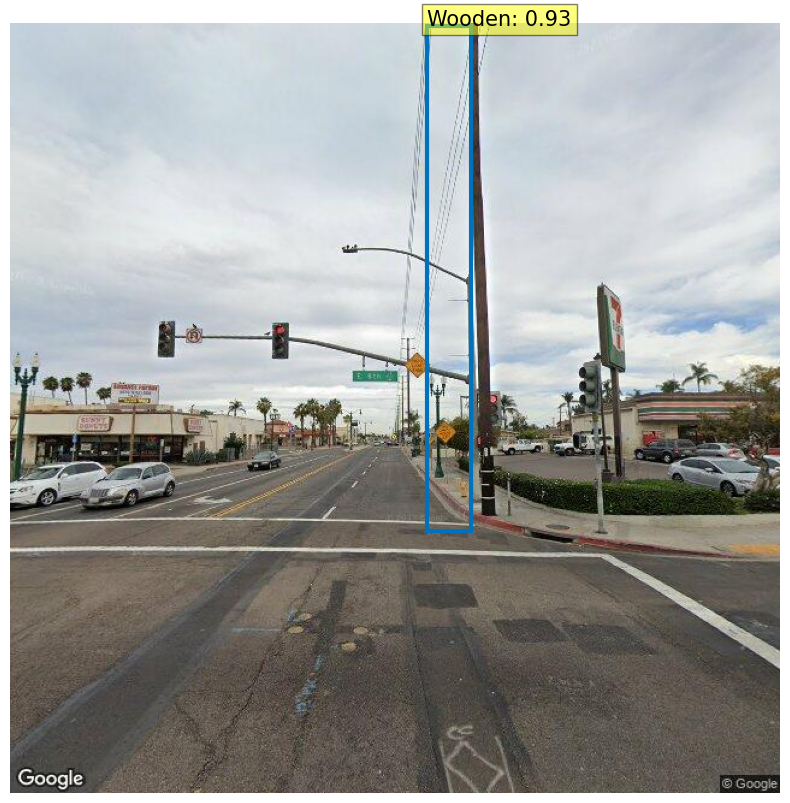

test/left1_-90_32.678190473415114_-117.09848821889095.jpg
HEIGHT: 206.46414184570312
False
HEIGHT: 388.4786262512207
True


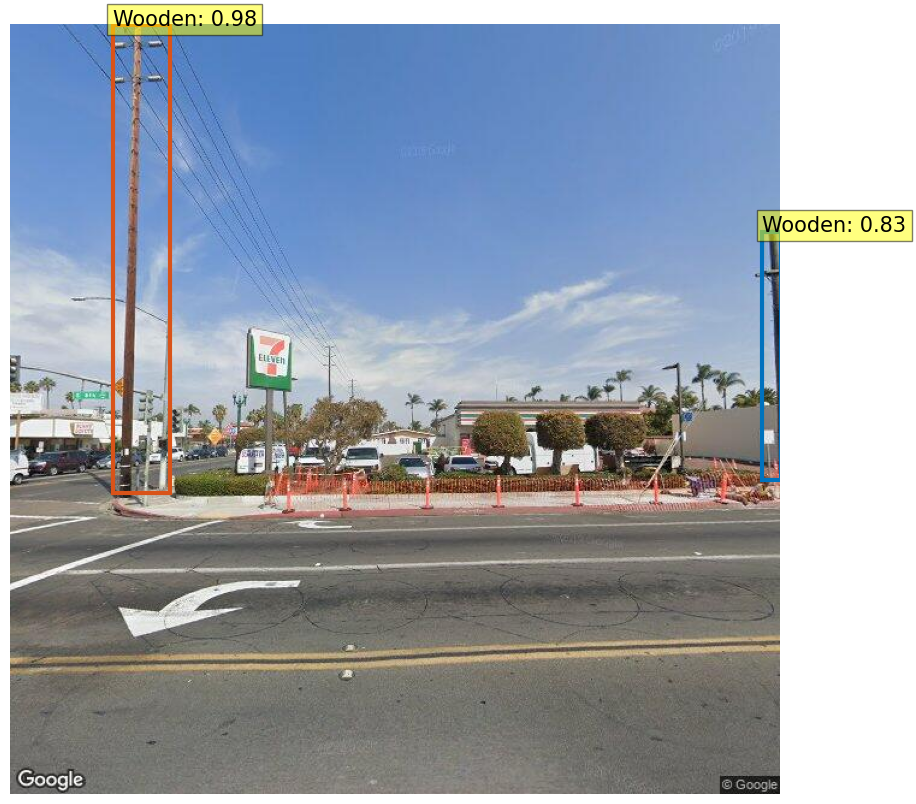

test/left2_-90_32.67822112235852_-117.09839303148492.jpg
HEIGHT: 404.47212982177734
True


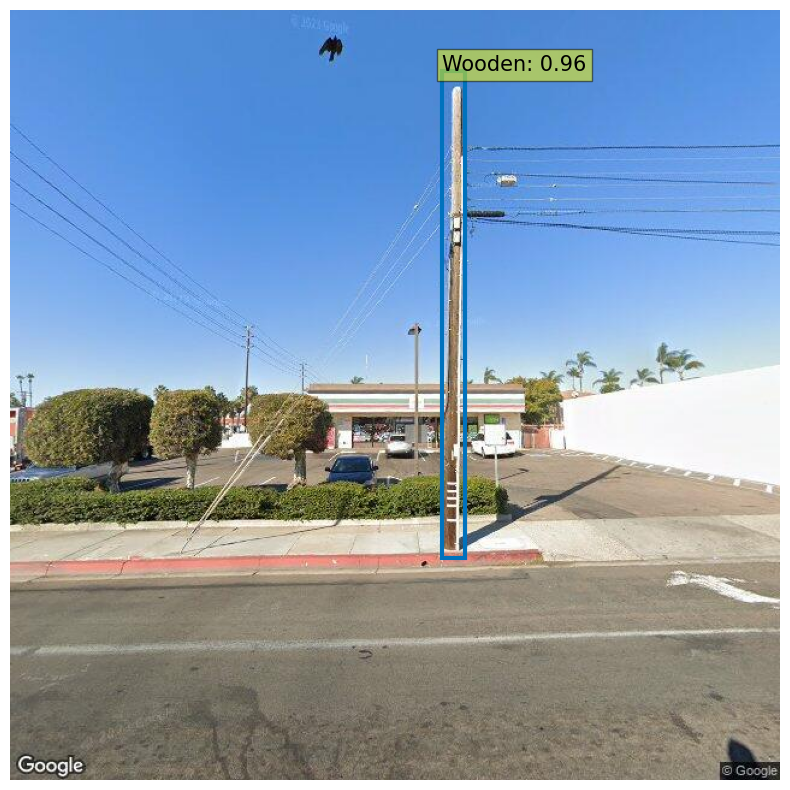

test/left3_-90_32.678267095773634_-117.09825025037587.jpg
HEIGHT: 281.03077697753906
True


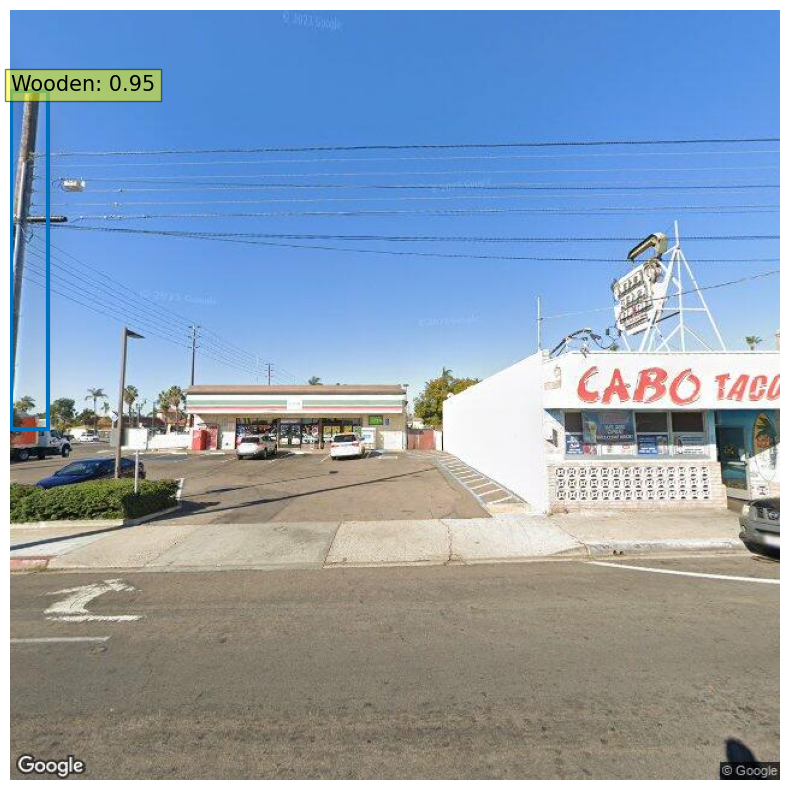

test/left4_-90_32.67831306918875_-117.09810746926682.jpg


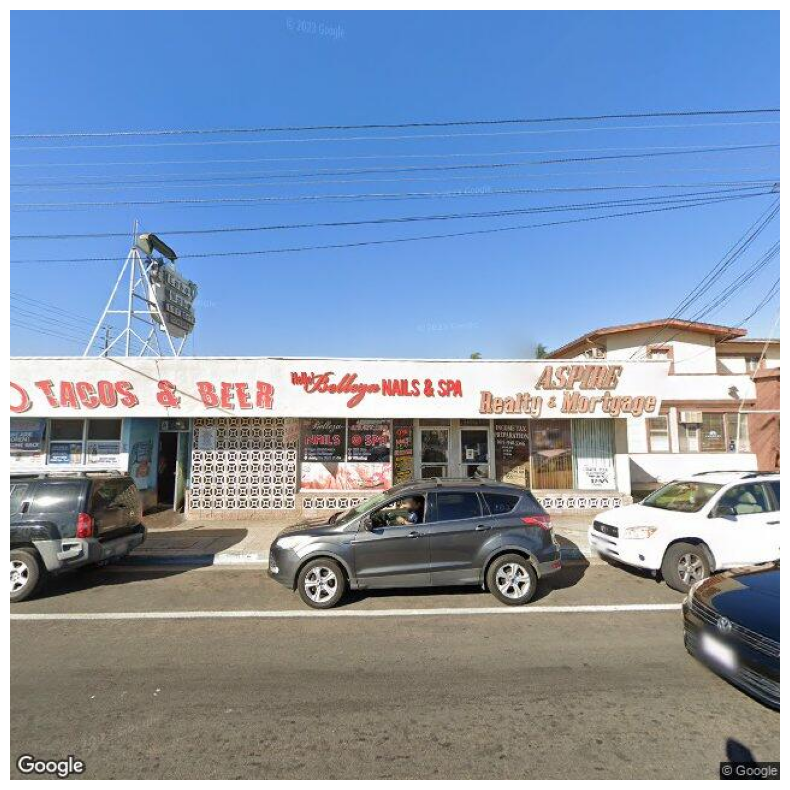

test/left5_-90_32.67837436707556_-117.09791709445476.jpg
HEIGHT: 66.09478759765625
False
HEIGHT: 196.6145477294922
False
HEIGHT: 193.98394775390625
False
HEIGHT: 66.00210571289062
False


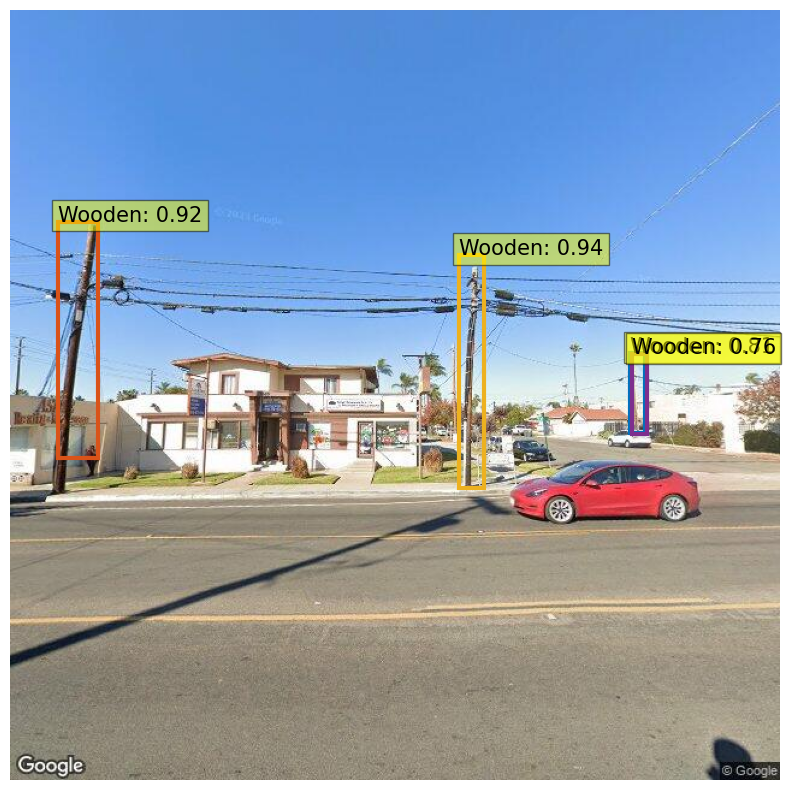

test/left6_-90_32.67843566496238_-117.0977267196427.jpg
HEIGHT: 104.15243530273438
False


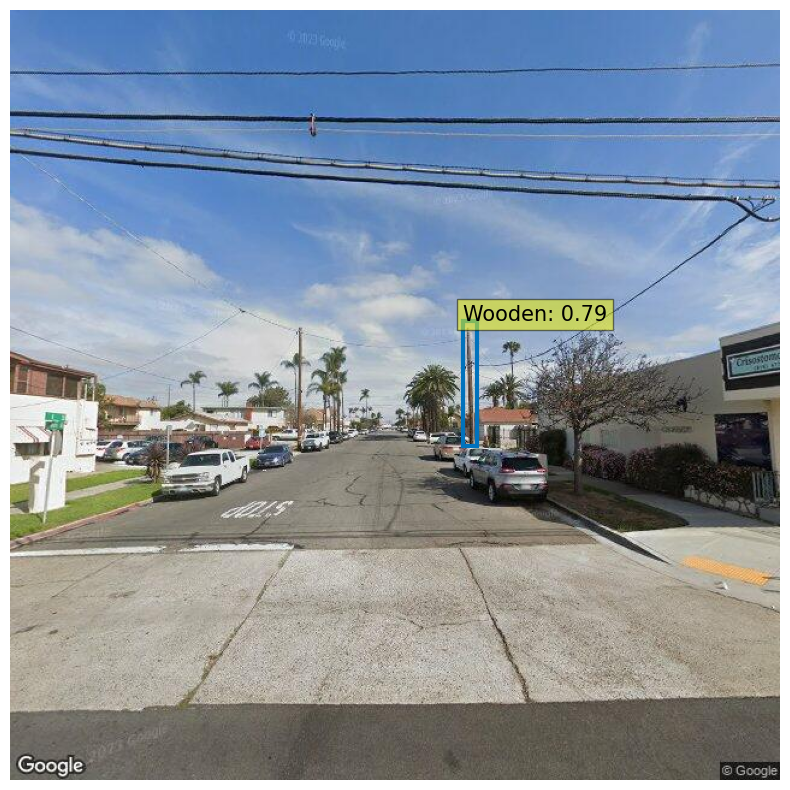

test/left7_-90_32.67848163837749_-117.09758393853365.jpg


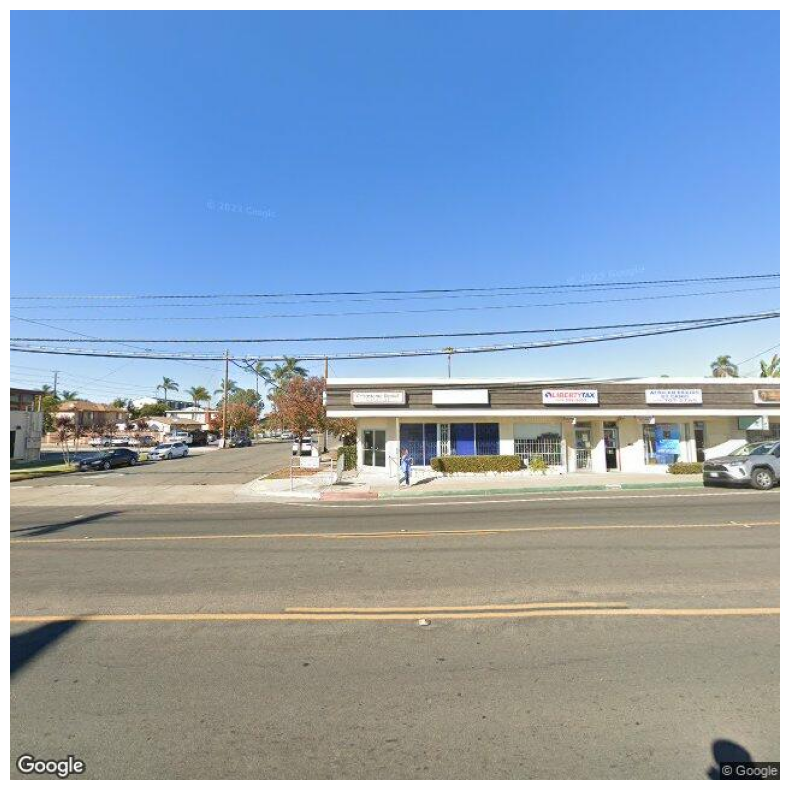

test/left8_-90_32.67854293626431_-117.09739356372158.jpg
HEIGHT: 188.43911743164062
False


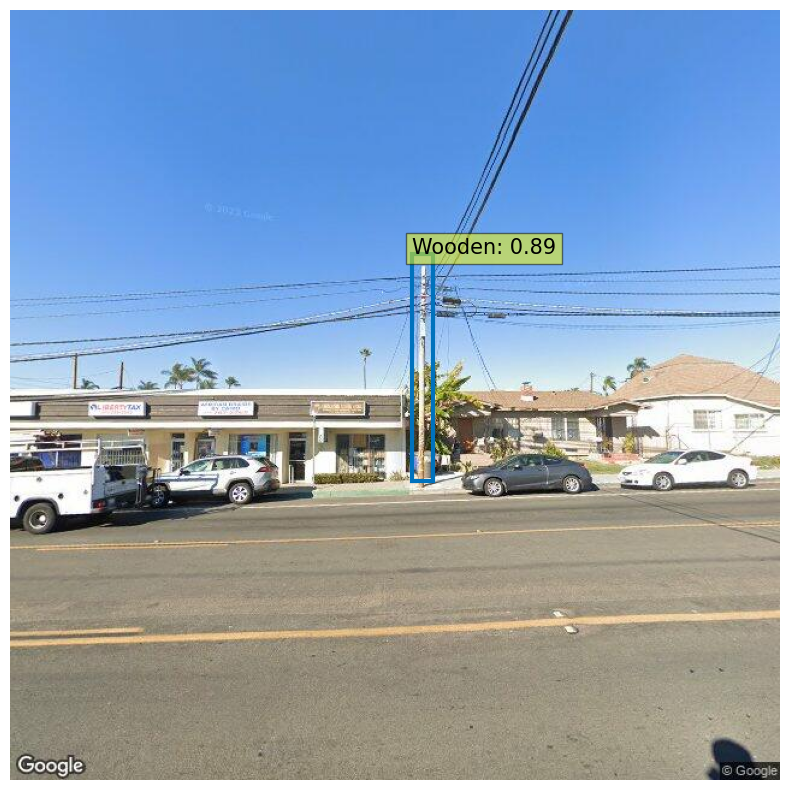

test/left9_-90_32.67860423415112_-117.09720318890952.jpg


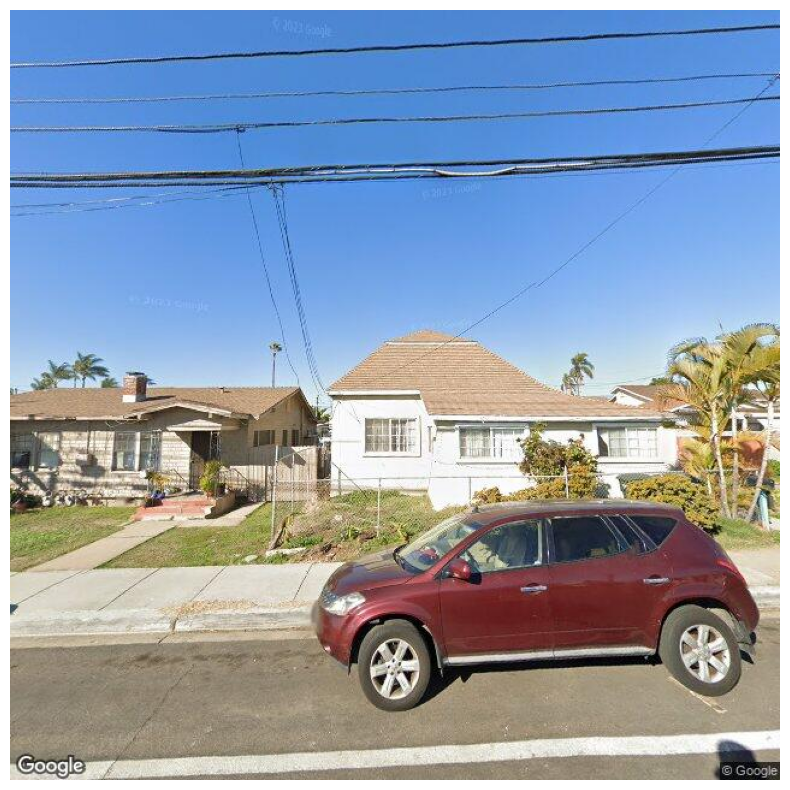

test/left10_-90_32.67866553203794_-117.09701281409745.jpg
HEIGHT: 472.3792304992676
True


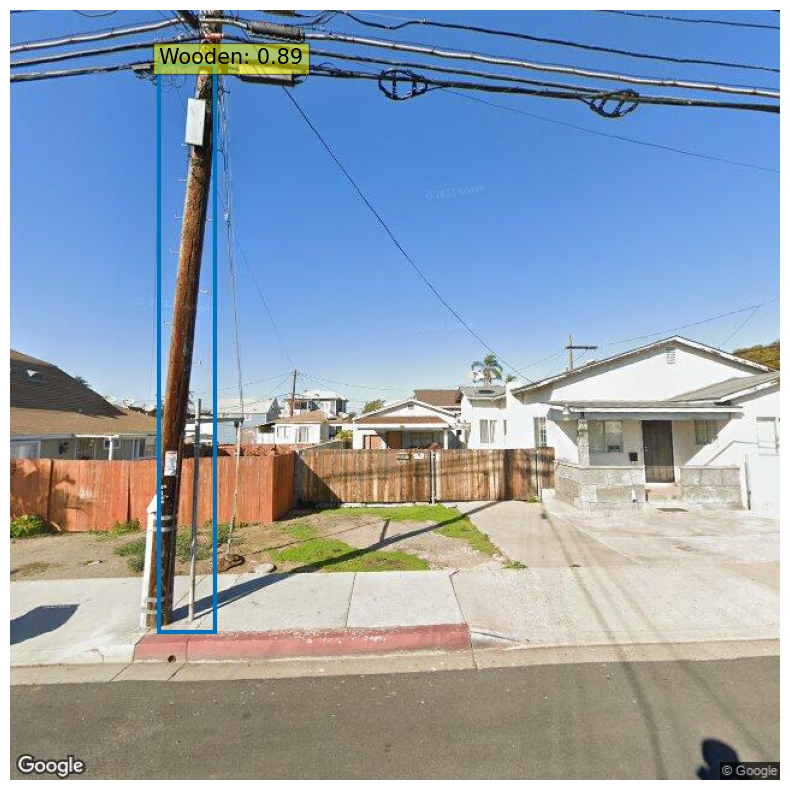

test/left11_-90_32.67869618098135_-117.09691762669142.jpg
HEIGHT: 177.29647827148438
False


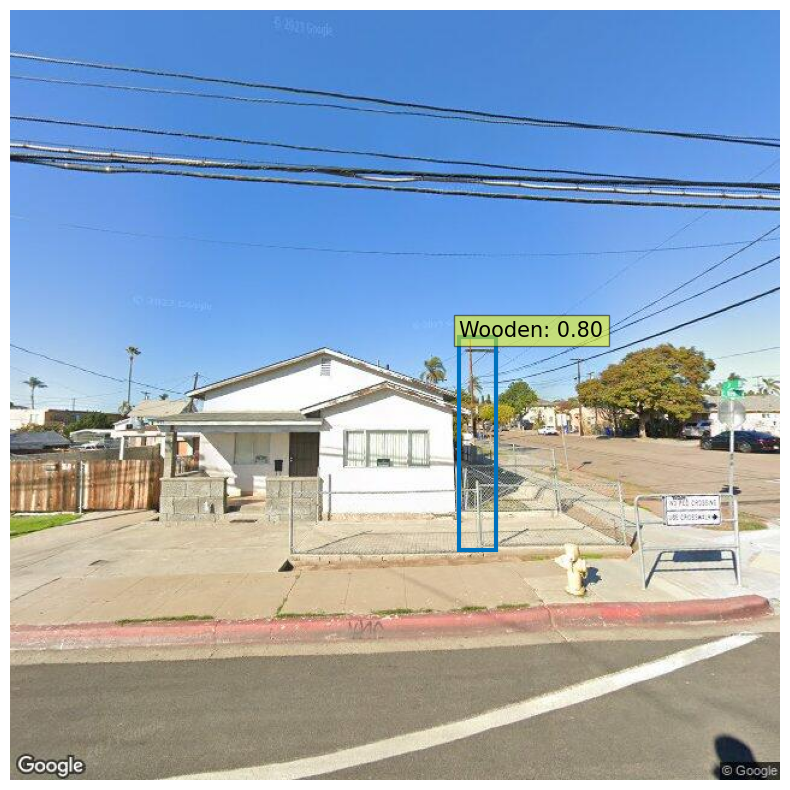

test/right0_90_32.6781445_-117.098631.jpg
HEIGHT: 250.0160369873047
True


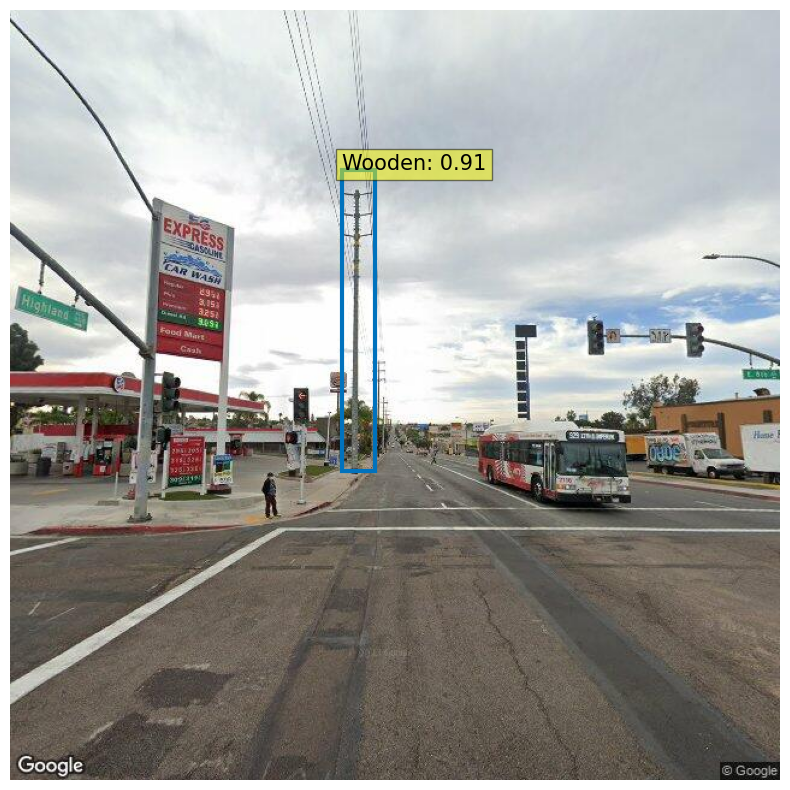

test/right1_90_32.678190473415114_-117.09848821889095.jpg
HEIGHT: 275.81214141845703
True
HEIGHT: 391.73366928100586
True


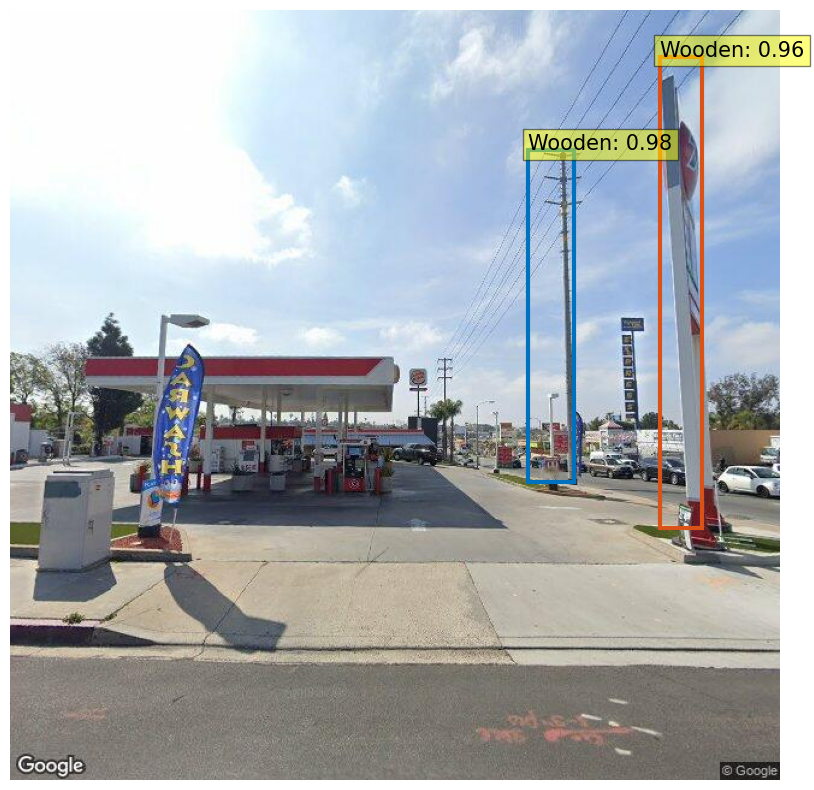

test/right2_90_32.67822112235852_-117.09839303148492.jpg
HEIGHT: 221.14614868164062
False


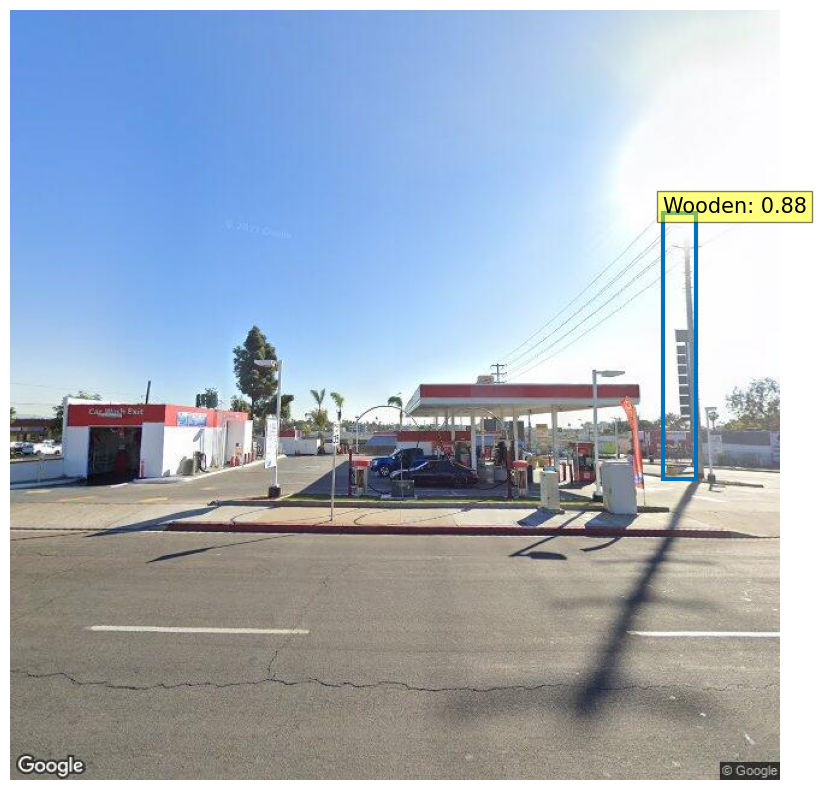

test/right3_90_32.678267095773634_-117.09825025037587.jpg


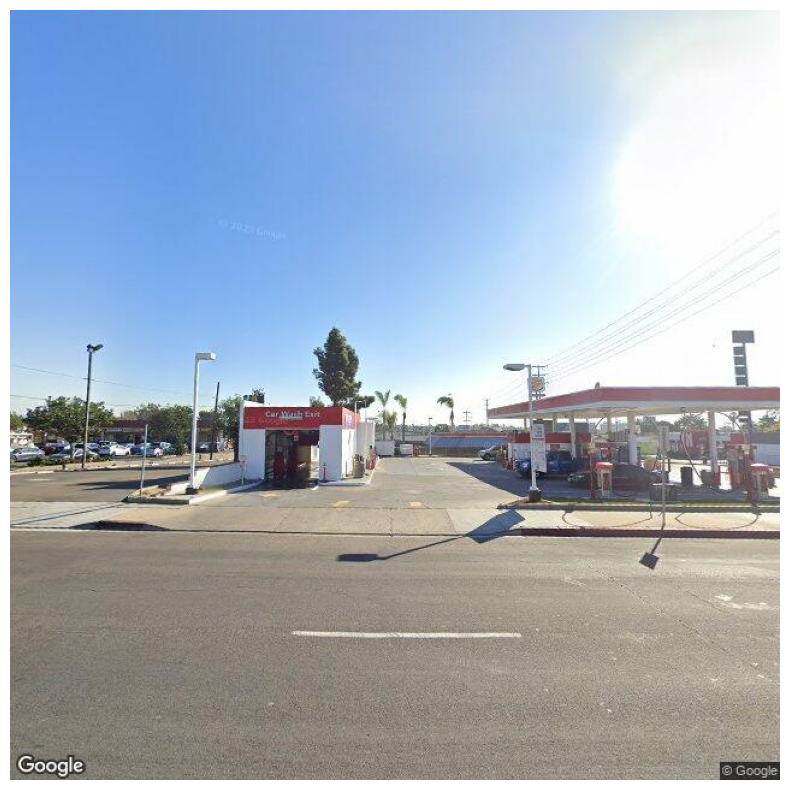

test/right4_90_32.67831306918875_-117.09810746926682.jpg
HEIGHT: 381.1542434692383
True
HEIGHT: 385.2327537536621
True


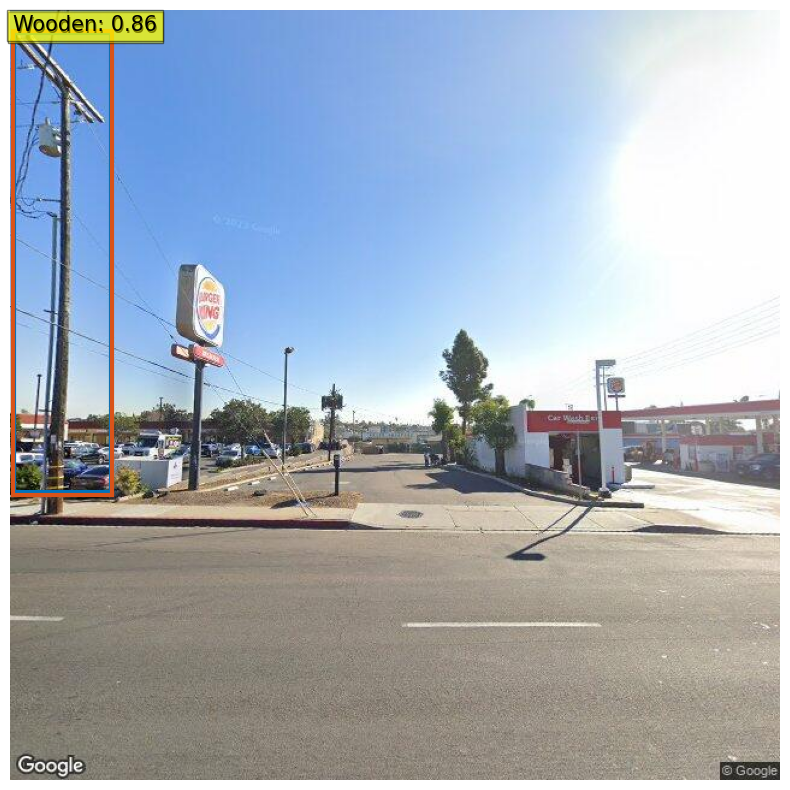

test/right5_90_32.67837436707556_-117.09791709445476.jpg
HEIGHT: 128.44024658203125
False


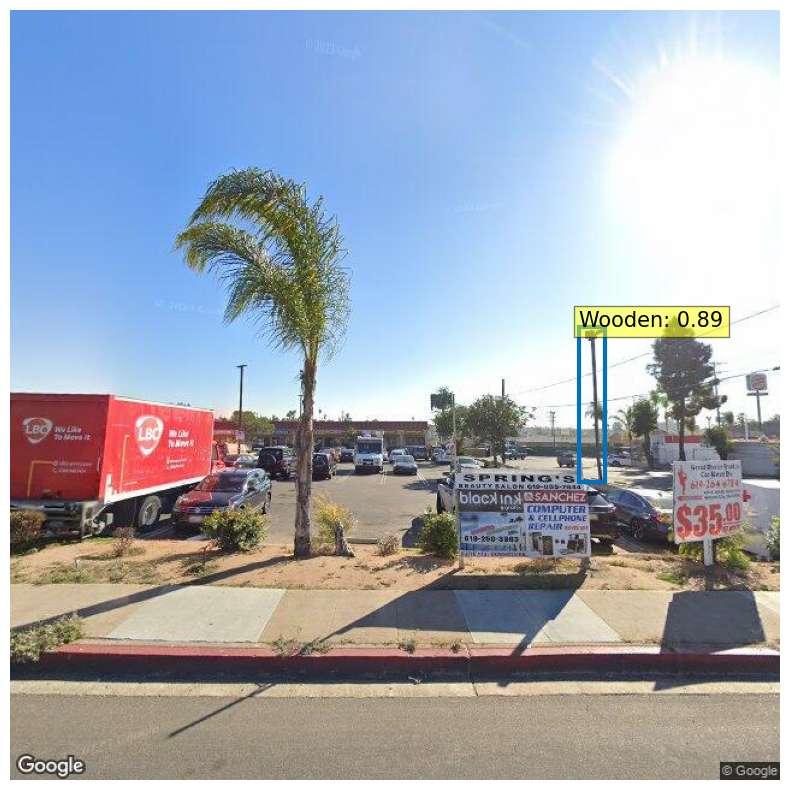

test/right6_90_32.67843566496238_-117.0977267196427.jpg
HEIGHT: 177.37918090820312
False
HEIGHT: 272.0039367675781
True


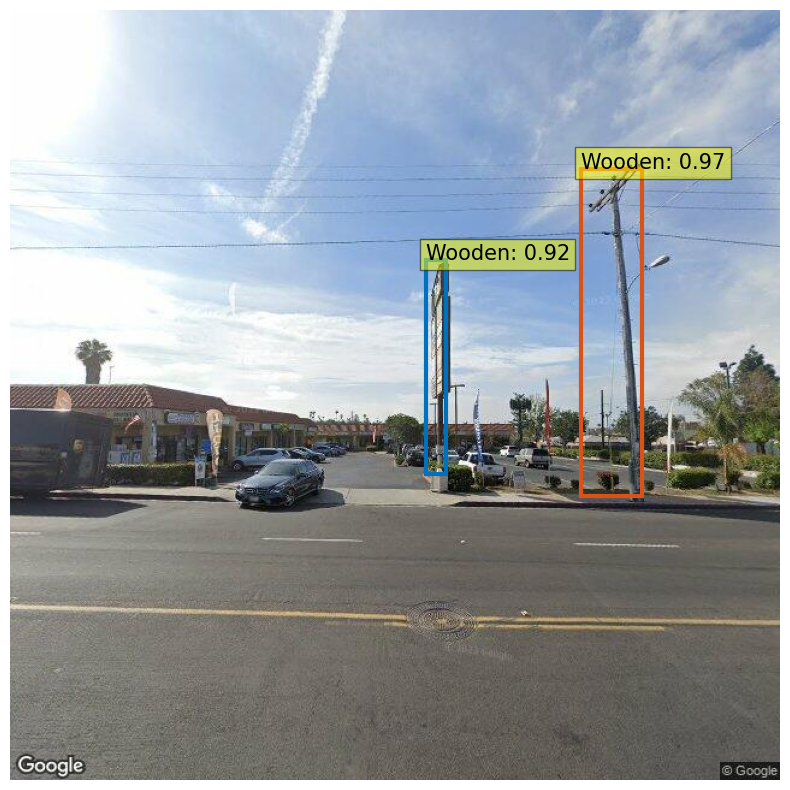

test/right7_90_32.67848163837749_-117.09758393853365.jpg


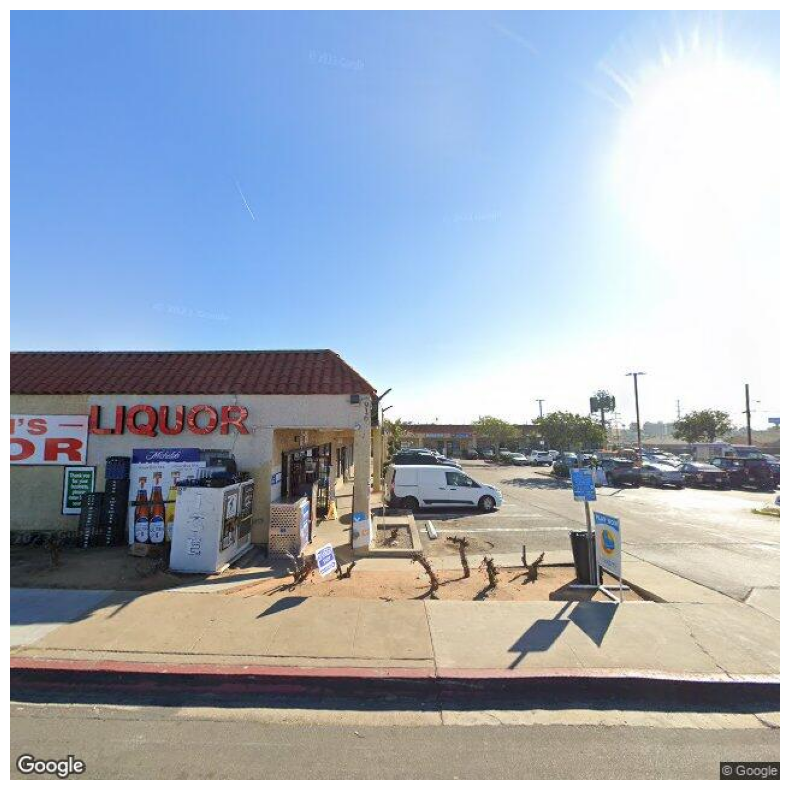

test/right8_90_32.67854293626431_-117.09739356372158.jpg
HEIGHT: 535.1395034790039
True


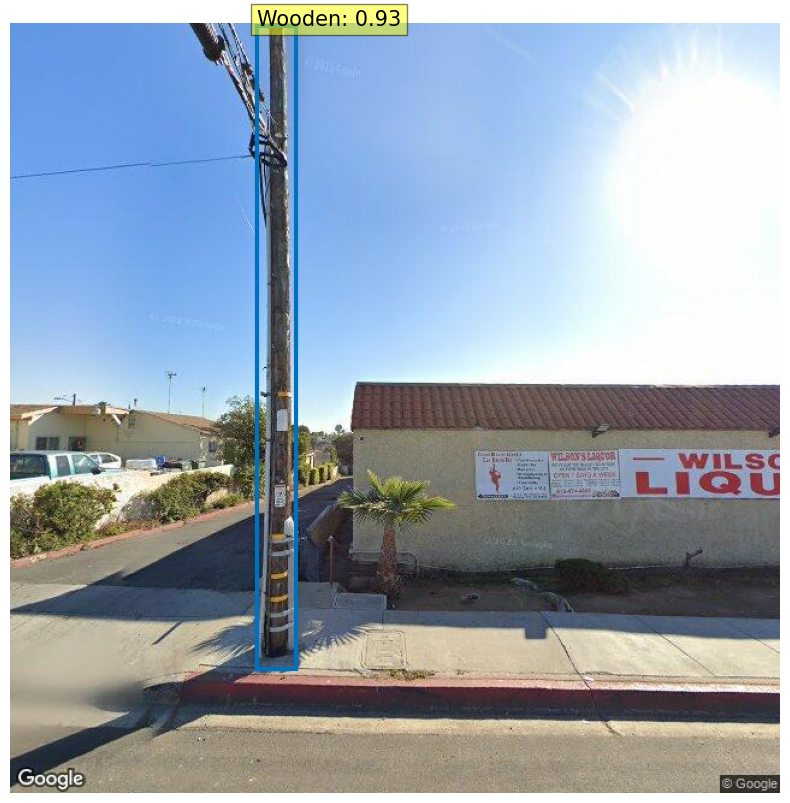

test/right9_90_32.67860423415112_-117.09720318890952.jpg
HEIGHT: 81.44223022460938
False
HEIGHT: 246.77450561523438
False


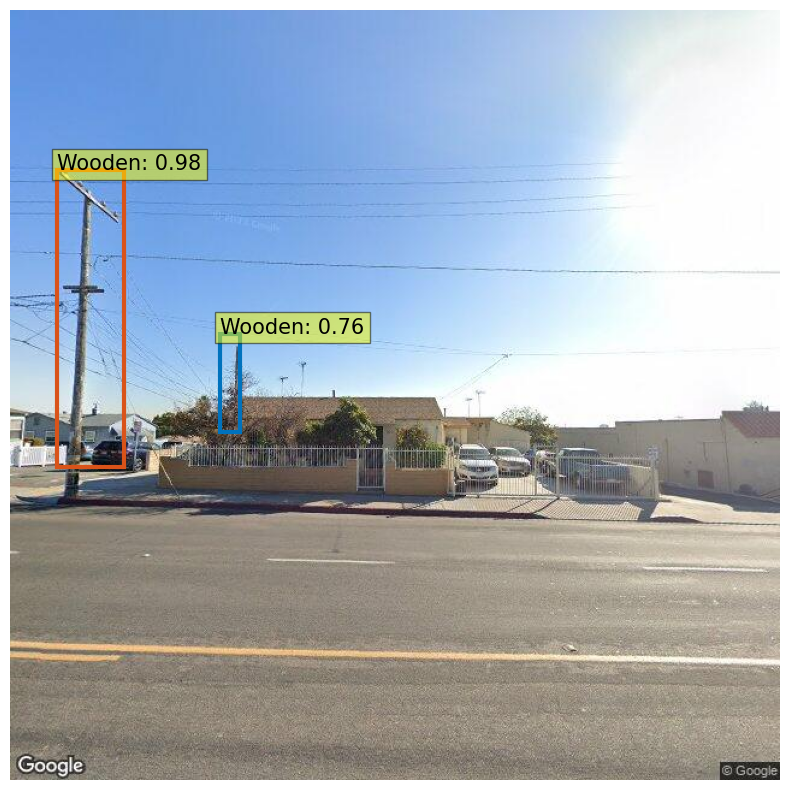

test/right10_90_32.67866553203794_-117.09701281409745.jpg
HEIGHT: 256.4019775390625
True
HEIGHT: 97.46450805664062
False


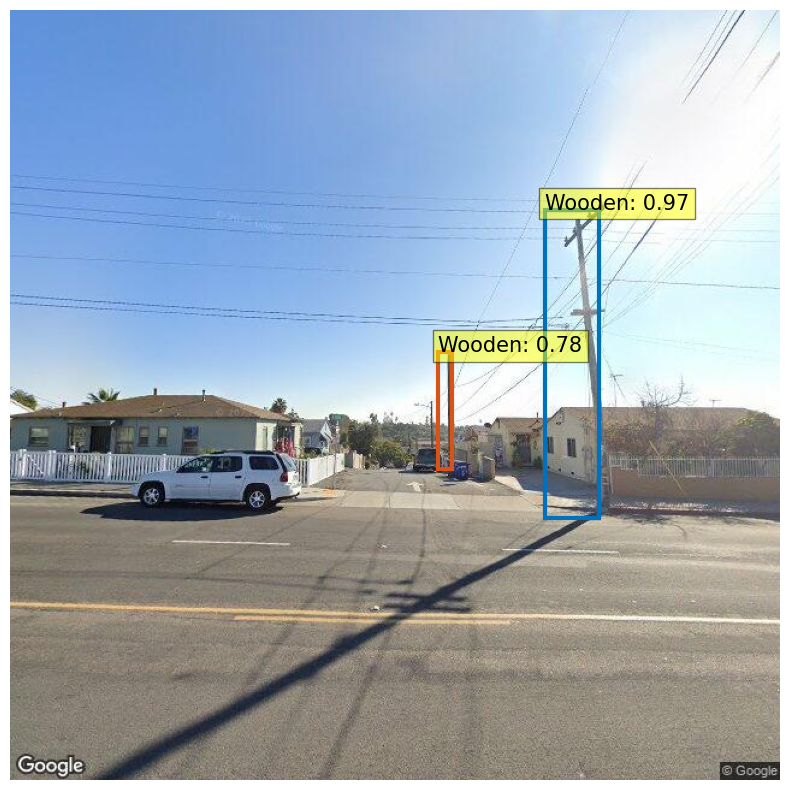

test/right11_90_32.67869618098135_-117.09691762669142.jpg
HEIGHT: 268.3017807006836
True


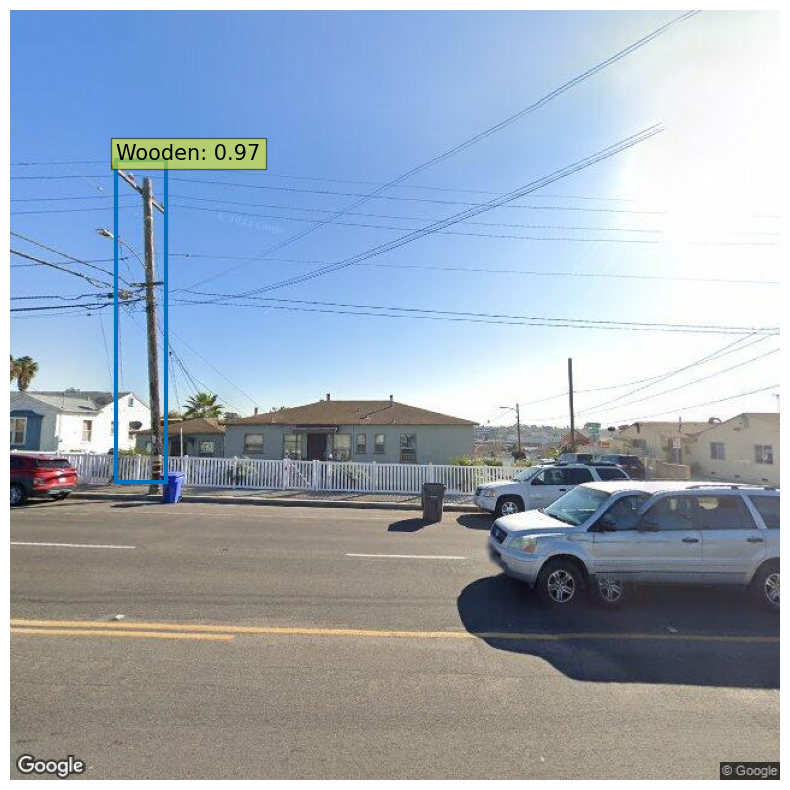

In [37]:
image_paths = glob.glob('test/*.jpg')
left_images = []
right_images = []

for image in image_paths:
    if 'left' in image:
        left_images.append(image)
    else:
        right_images.append(image)
        
left_images = sorted(left_images, key=natural_sort_key)
right_images = sorted(right_images, key=natural_sort_key)

for image in left_images:
    print(image)    
    im = Image.open(image)

    run_worflow(im, model, image)
    
for image in right_images:
    print(image)    
    im = Image.open(image)

    run_worflow(im, model, image)

In [38]:
cur.execute(
    '''
    SELECT * FROM mypoles;
    '''
)

In [39]:
# Fetch all rows from the result set
rows = cur.fetchall()

# Print the result
for row in rows:
    print(row)

(1, 32.6781445, -117.098631, 'Wooden')
(2, 32.678190473415114, -117.09848821889095, 'Wooden')
(3, 32.67822112235852, -117.09839303148492, 'Wooden')
(4, 32.678267095773634, -117.09825025037587, 'Wooden')
(5, 32.67866553203794, -117.09701281409745, 'Wooden')
(6, 32.6781445, -117.098631, 'Wooden')
(7, 32.678190473415114, -117.09848821889095, 'Wooden')
(8, 32.678190473415114, -117.09848821889095, 'Wooden')
(9, 32.67831306918875, -117.09810746926682, 'Wooden')
(10, 32.67831306918875, -117.09810746926682, 'Wooden')
(11, 32.67843566496238, -117.0977267196427, 'Wooden')
(12, 32.67854293626431, -117.09739356372158, 'Wooden')
(13, 32.67866553203794, -117.09701281409745, 'Wooden')
(14, 32.67869618098135, -117.09691762669142, 'Wooden')


In [40]:
my_poles_count = {'Wooden': 0, 'Metal': 0}

for row in rows:
    if row[-1] == 'Wooden':
        my_poles_count['Wooden'] += 1
    else:
        my_poles_count['Metal'] += 1
    
my_poles_count

{'Wooden': 14, 'Metal': 0}

In [42]:
#test_2
cur.execute(
    '''
    SELECT *
    FROM poles
    WHERE
        -- Haversine formula for distance calculation
        6371000 * 2 * ASIN(
            SQRT(
                POWER(SIN(RADIANS((latitude - 32.8209644) / 2)), 2) +
                COS(RADIANS(32.8209644)) * COS(RADIANS(latitude)) *
                POWER(SIN(RADIANS((longitude + 117.1861909) / 2)), 2)
            )
        ) <= 100 -- distance in meters
        OR
        6371000 * 2 * ASIN(
            SQRT(
                POWER(SIN(RADIANS((latitude - 32.8195283) / 2)), 2) +
                COS(RADIANS(32.8195283)) * COS(RADIANS(latitude)) *
                POWER(SIN(RADIANS((longitude + 117.1861259) / 2)), 2)
            )
        ) <= 100; -- distance in meters

    '''
)

In [43]:
# test
cur.execute(
    '''
    SELECT *
    FROM poles
    WHERE
        -- Haversine formula for distance calculation
        6371000 * 2 * ASIN(
            SQRT(
                POWER(SIN(RADIANS((latitude - 32.6781445) / 2)), 2) +
                COS(RADIANS(32.6781445)) * COS(RADIANS(latitude)) *
                POWER(SIN(RADIANS((longitude + 117.098631) / 2)), 2)
            )
        ) <= 100 -- distance in meters
        OR
        6371000 * 2 * ASIN(
            SQRT(
                POWER(SIN(RADIANS((latitude - 32.6787394) / 2)), 2) +
                COS(RADIANS(32.6787394)) * COS(RADIANS(latitude)) *
                POWER(SIN(RADIANS((longitude + 117.0967834) / 2)), 2)
            )
        ) <= 100; -- distance in meters

    '''
)

In [44]:
# Fetch all rows from the result set
rows = cur.fetchall()

# Print the result
for row in rows:
    print(row)

(10, 32.6781706, -117.0986694, 'Wooden')
(11, 32.6782575, -117.0983719, 'Wooden')
(12, 32.6783658, -117.0979953, 'Wooden')
(13, 32.6783413, -117.097868, 'Wooden')
(14, 32.6783692, -117.0977638, 'Wooden')
(15, 32.6784841, -117.0973523, 'Wooden')
(16, 32.6784841, -117.0973523, 'Wooden')
(17, 32.6784841, -117.0973523, 'Wooden')
(18, 32.6784841, -117.0973523, 'Wooden')
(19, 32.6784841, -117.0973523, 'Wooden')


In [45]:
db_poles_count = {'Wooden': 0, 'Metal': 0}

for row in rows:
    if row[-1] == 'Wooden':
        db_poles_count['Wooden'] += 1
    else:
        db_poles_count['Metal'] += 1
    
db_poles_count

{'Wooden': 10, 'Metal': 0}

In [46]:
cur.execute(
    '''
    DROP TABLE mypoles;
    '''
)